# Code for part II of the assessment 
## based on practical week 6 by Andrew Renninger

## Let us get the data: road network, supermarkets and OAs

In [1]:
import networkx as nx
import osmnx as ox
import pandas as pd
import geopandas as gpd
import numpy as np

import matplotlib.pyplot as plt

let's start by getting the data, something you are already familiar with

In [2]:
# grab the street network for our area of interest
G = ox.graph.graph_from_place('Borough of Havering, London, UK', network_type='walk')

In [3]:
#n. of street intersections
len(G)

16351

In [4]:
# get the administrative boundary of the area
area = ox.geocode_to_gdf('Borough of Havering, London, UK')

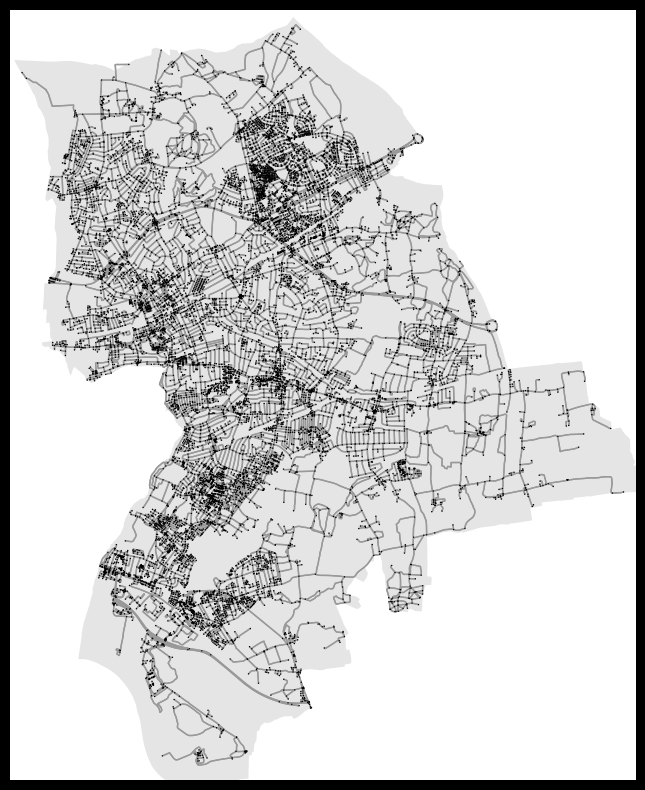

(<Figure size 1000x1000 with 1 Axes>, <Axes: >)

In [5]:
# plot the network on the area
fig, ax = plt.subplots(figsize=(10, 10),facecolor='k')
area.plot(ax=ax, facecolor='k', alpha=0.1)
ox.plot_graph(G, ax=ax, node_color='k', node_size=1)

for this and the assessment, we are going to use data on supermarkets from geolytix

In [6]:
retail = pd.read_csv("./geolytix_retailpoints_v34_202412.csv")
retail = gpd.GeoDataFrame(retail, geometry=gpd.points_from_xy(retail['long_wgs'], retail['lat_wgs']), crs="EPSG:4326")
retail = retail[retail['geometry'].within(area.loc[0, 'geometry'])]
retail.head()

,id,retailer,fascia,store_name,add_one,add_two,town,suburb,postcode,long_wgs,lat_wgs,bng_e,bng_n,pqi,open_date,size_band,county,geometry
8880,1010001769,Marks and Spencer,Marks and Spencer BP,M&S Hornchurch BP,Southend Arterial Road,NaN,London,Emerson Park,RM11 3UJ,0.240395,51.579830,555332.371570,189152.128284,Rooftop,NaN,"< 3,013 ft2 (280m2)",Greater London,POINT (0.2404 51.57983)
8881,1010000785,Asda,Asda Superstore,Asda Romford Superstore,Dolphin Approach,Mercury Gardens,London,Romford,RM1 3EE,0.185560,51.579473,551534.511561,188997.348277,Rooftop,NaN,"30,138 ft2 > (2,800 m2)",Greater London,POINT (0.18556 51.57947)
8882,1010008077,The Co-operative Group,The Co-operative Food,Co-op Harold Wood,15 Station Road,Harold Wood,London,Harold Wood,RM3 0BP,0.233400,51.593581,554801.026269,190666.388789,Rooftop,NaN,"< 3,013 ft2 (280m2)",Greater London,POINT (0.2334 51.59358)
8883,1010011531,Chelmsford Star Co-operative Society,The Co-operative Food,Co-op Mungo Park,150 Mungo Park Road,NaN,London,Elm Park,RM13 7PP,0.192236,51.540285,552127.681563,184653.568262,Rooftop,NaN,"< 3,013 ft2 (280m2)",Greater London,POINT (0.19224 51.54028)
8884,1010014460,The Southern Co-operative,The Co-operative Food,Co-op Hornchurch - Hornchurch Road,176-178 Hornchurch Road,NaN,London,Heath Park,RM11 1QL,0.200812,51.564993,552639.622492,187418.963916,Rooftop,20179999.0,"< 3,013 ft2 (280m2)",Greater London,POINT (0.20081 51.56499)


In [7]:
# how many grocery locations are there?
retail.shape

(56, 18)

In [8]:
# For the spatial interaction model, we need to area of the supermarkets as the attraction factor.
# let us extract it
import re
def extract_square_meter(x):
    # natch the square meter value, even if there is a range
    match = re.search(r'\((\d{1,3}(?:,\d{3})*)\s*(?:<\s*\d{1,3}(?:,\d{3})*)?\s*m2\)', x)
    if match:
        # extract the first value in the range, or the single value
        square_meter_str = match.group(1).replace(",", "")
        return int(square_meter_str)
    return None

retail['square_meters'] = retail['size_band'].apply(lambda x: extract_square_meter(x))
retail.head()


,id,retailer,fascia,store_name,add_one,add_two,town,suburb,postcode,long_wgs,lat_wgs,bng_e,bng_n,pqi,open_date,size_band,county,geometry,square_meters
8880,1010001769,Marks and Spencer,Marks and Spencer BP,M&S Hornchurch BP,Southend Arterial Road,NaN,London,Emerson Park,RM11 3UJ,0.240395,51.579830,555332.371570,189152.128284,Rooftop,NaN,"< 3,013 ft2 (280m2)",Greater London,POINT (0.2404 51.57983),280
8881,1010000785,Asda,Asda Superstore,Asda Romford Superstore,Dolphin Approach,Mercury Gardens,London,Romford,RM1 3EE,0.185560,51.579473,551534.511561,188997.348277,Rooftop,NaN,"30,138 ft2 > (2,800 m2)",Greater London,POINT (0.18556 51.57947),2800
8882,1010008077,The Co-operative Group,The Co-operative Food,Co-op Harold Wood,15 Station Road,Harold Wood,London,Harold Wood,RM3 0BP,0.233400,51.593581,554801.026269,190666.388789,Rooftop,NaN,"< 3,013 ft2 (280m2)",Greater London,POINT (0.2334 51.59358),280
8883,1010011531,Chelmsford Star Co-operative Society,The Co-operative Food,Co-op Mungo Park,150 Mungo Park Road,NaN,London,Elm Park,RM13 7PP,0.192236,51.540285,552127.681563,184653.568262,Rooftop,NaN,"< 3,013 ft2 (280m2)",Greater London,POINT (0.19224 51.54028),280
8884,1010014460,The Southern Co-operative,The Co-operative Food,Co-op Hornchurch - Hornchurch Road,176-178 Hornchurch Road,NaN,London,Heath Park,RM11 1QL,0.200812,51.564993,552639.622492,187418.963916,Rooftop,20179999.0,"< 3,013 ft2 (280m2)",Greater London,POINT (0.20081 51.56499),280


In [9]:
nodes, edges = ox.graph_to_gdfs(G)

Text(0.5, 1.0, 'Retail locations in Havering, London')

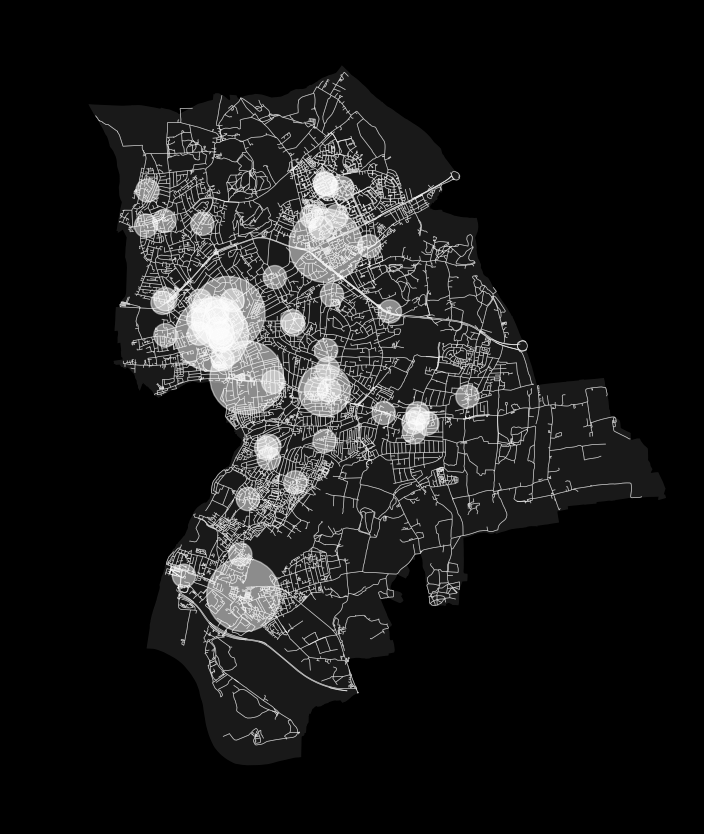

In [10]:
# let us plot the supermarkets according to their size 
fig, ax = plt.subplots(figsize=(10, 10), facecolor='k')
area.plot(ax=ax, facecolor='w', alpha=0.1)
edges.plot(color='w', ax=ax, linewidth=0.5, alpha=0.5)
retail.plot(color='w', ax=ax, markersize='square_meters', alpha=0.5)
ax.set_facecolor('k')
ax.set_title('Retail locations in Havering, London')

In [11]:
# what are the biggest stores
retail = retail.sort_values('square_meters', ascending=False)
retail.head()

,id,retailer,fascia,store_name,add_one,add_two,town,suburb,postcode,long_wgs,lat_wgs,bng_e,bng_n,pqi,open_date,size_band,county,geometry,square_meters
8897,1010006288,Tesco,Tesco Extra,Tesco Rainham Extra,Bridge Road,Rainham,London,Rainham,RM13 9YZ,0.190737,51.520074,552091.001563,182402.998253,Rooftop,NaN,"30,138 ft2 > (2,800 m2)",Greater London,POINT (0.19074 51.52007),2800
8881,1010000785,Asda,Asda Superstore,Asda Romford Superstore,Dolphin Approach,Mercury Gardens,London,Romford,RM1 3EE,0.185560,51.579473,551534.511561,188997.348277,Rooftop,NaN,"30,138 ft2 > (2,800 m2)",Greater London,POINT (0.18556 51.57947),2800
8910,1010003189,Sainsburys,Sainsburys,Sainsburys Romford,1 The Brewery,NaN,London,Romford,RM1 1AU,0.179965,51.574915,551162.001560,188478.998274,Rooftop,NaN,"30,138 ft2 > (2,800 m2)",Greater London,POINT (0.17997 51.57492),2800
18264,1010006287,Tesco,Tesco Extra,Tesco Romford Extra,300 Hornchurch Road,Hornchurch,London,Heath Park,RM11 1PY,0.191840,51.565854,552015.001562,187495.998272,Rooftop,NaN,"30,138 ft2 > (2,800 m2)",Greater London,POINT (0.19184 51.56585),2800
8896,1010006290,Tesco,Tesco Extra,Tesco Romford Gallows Corner Extra,Bryant Avenue,Romford,London,Harold Wood,RM3 0LL,0.218663,51.593686,553780.001567,190646.998287,Rooftop,NaN,"30,138 ft2 > (2,800 m2)",Greater London,POINT (0.21866 51.59369),2800


In [12]:
# let us put the stores in the network. We get the nearest network node to each supermarket
retail['nodes'] = ox.nearest_nodes(G, retail['long_wgs'], retail['lat_wgs'])

In [13]:
# Each supermarket gets associated with a node (intersection point in the network)
retail['nodes'].to_numpy()

array([ 3126695258,    33472352,  2905549031,  4525271306,  1723271155,
        7097574945,    31073549, 11227619384,   245794863, 11909545221,
          31497656,    30865750,  5385551038,  5865912846,  7261100452,
        6322924734,  8628074642,  6332783669,    25894895,  2184904585,
        1567651769,  2142099759,    31387232,  8209435887,  8817642959,
        1127943270,   245015254, 10749201507, 12670836514,  3232129350,
          27340030,   747087848,  8205579182,  4472253157,  5380508003,
          31388110,  8091496508,    30991535,   245035059,  6769246246,
        4520240128,  6322924734,   747087748,  1266089657, 11132894624,
        3565590107,    45403833,    32567383,   245037871,  1612627338,
        2962708960,  2733299480, 11599007720,  3787358413,  6970755181,
        7265453259])

we have now assigned each interaction to its nearest grocery store

In [15]:
#Now let us get the administrative units: OAs and take only the area defined
oa = gpd.read_file("./loac/loac_oa.gpkg")
oa = oa.to_crs(4326)
oa = oa[oa['geometry'].centroid.within(area.loc[0, 'geometry'])]
oa.head()

/var/folders/85/qwxqq_js7zlfvgcsrmsf23t80000gn/T/ipykernel_40663/3835493417.py:4: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  oa = oa[oa['geometry'].centroid.within(area.loc[0, 'geometry'])]


,OA21CD,G,SG,geometry
10547,E00011202,F2,F,"MULTIPOLYGON (((0.15152 51.56798, 0.15081 51.5..."
10548,E00011203,C2,C,"MULTIPOLYGON (((0.17613 51.56765, 0.17642 51.5..."
10549,E00011204,F1,F,"MULTIPOLYGON (((0.16159 51.57077, 0.16296 51.5..."
10550,E00011205,C2,C,"MULTIPOLYGON (((0.18131 51.56826, 0.18306 51.5..."
10551,E00011206,F1,F,"MULTIPOLYGON (((0.18696 51.56557, 0.18624 51.5..."


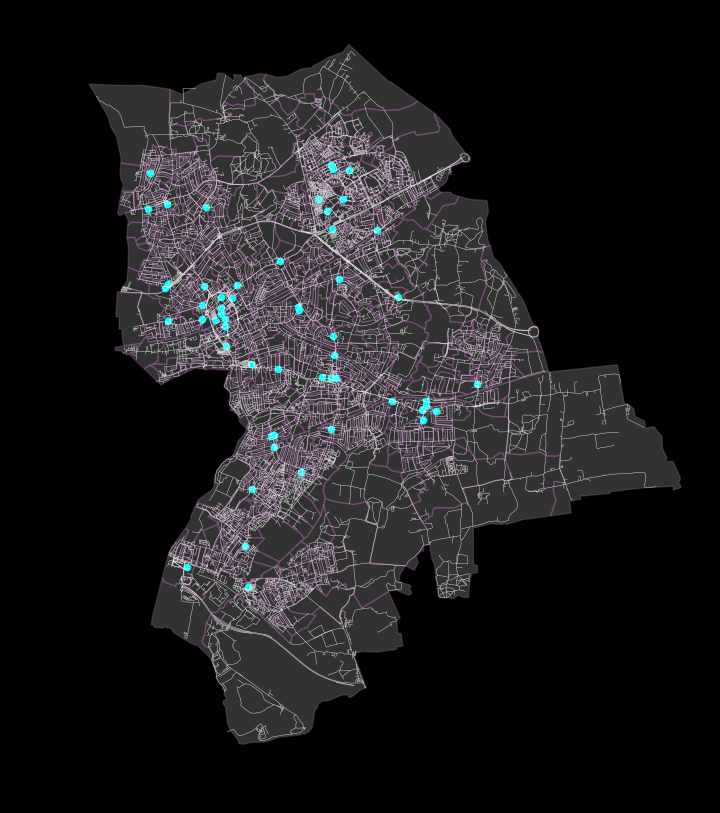

In [16]:
fig, ax = plt.subplots(figsize=(10, 10), facecolor='k')
oa.plot(ax=ax, facecolor='w', alpha=0.2,edgecolor='violet', linewidth=1)
edges.plot(color='w', ax=ax, linewidth=0.3, alpha=0.5)
retail.plot(color='cyan', ax=ax, markersize=20)
ax.set_facecolor('k')

In [17]:
oa.shape

(775, 4)

## A new supermarket will be constructed. You will be given 2 potential places
### Let those be: E00011326 and E00011710

In [18]:
# let us create an interactive map to select the OA for the new supermarkets
import folium
from folium import GeoJson, GeoJsonTooltip


# Initialize the map centered around your geometries
center = oa.geometry.unary_union.centroid
m = folium.Map(location=[center.y, center.x], zoom_start=13, tiles="cartodbpositron")

# Add OAs as GeoJson with tooltips showing the OA ID
# Replace 'oa_id_column' with the actual column name that holds the OA ID
GeoJson(
    oa,
    name="OAs",
    tooltip=GeoJsonTooltip(fields=["OA21CD"], aliases=["OA ID:"]),
    style_function=lambda x: {
        "fillColor": "lightgray",
        "color": "black",
        "weight": 1,
        "fillOpacity": 0.5,
    },
    highlight_function=lambda x: {"weight": 3, "color": "red"},
).add_to(m)

# Let us add the street network, edges layer (white lines)
GeoJson(
    edges,
    name="Edges",
    style_function=lambda x: {
        "color": "grey",
        "weight": 0.5,
        "opacity": 0.5
    }
).add_to(m)

# now let us add the retail centres
for _, row in retail.iterrows():
    #size = 10
    size = row['square_meters'] / 100  # adjust scale as needed

    folium.CircleMarker(
        location=[row['lat_wgs'], row['long_wgs']],
        radius=size,
        color='violet',
        fill=True,
        fill_opacity=0.5,
        weight=0.5,
        popup=f"{row['square_meters']} m²"
    ).add_to(m)

# Add layer control (to toggle layers on/off)
folium.LayerControl().add_to(m)
# Show the map
m

/var/folders/85/qwxqq_js7zlfvgcsrmsf23t80000gn/T/ipykernel_40663/834403442.py:7: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  center = oa.geometry.unary_union.centroid


In [27]:
# Let us see where they are
oa_ids = ['E00011326', 'E00011710']  # Replace with your actual OA IDs
selected_oas = oa[oa['OA21CD'].isin(oa_ids)]

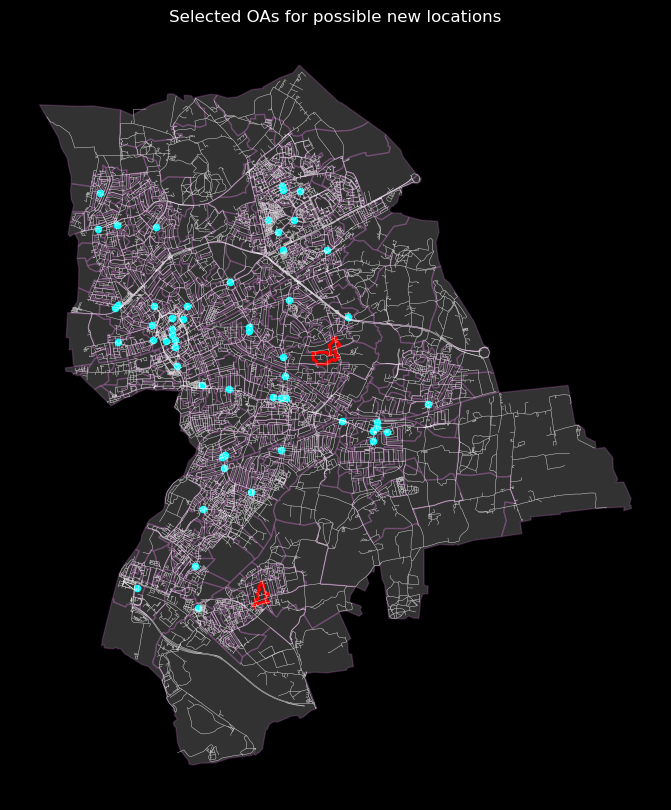

In [20]:
fig, ax = plt.subplots(figsize=(10, 10), facecolor='k')

# Plot all OAs
oa.plot(ax=ax, facecolor='w', alpha=0.2, edgecolor='violet', linewidth=1)

# Plot roads: edges
edges.plot(ax=ax, color='w', linewidth=0.3, alpha=0.5)

# Plot retail locations
retail.plot(ax=ax, color='cyan', markersize=20)

# Plot selected OAs on top — highlighted in red
selected_oas.plot(ax=ax, facecolor='none', edgecolor='red', linewidth=2)

# Set background
ax.set_facecolor('k')
ax.set_title("Selected OAs for possible new locations", color='white')

# Optional: turn off axis
ax.axis('off')

plt.show()

## Now need to get distances from OAs to supermarkets and 2 new possible supermarkets

In [21]:
# Let us take the centroid of each area and compute the distance
oa['lon'] = oa['geometry'].centroid.x
oa['lat'] = oa['geometry'].centroid.y

/var/folders/85/qwxqq_js7zlfvgcsrmsf23t80000gn/T/ipykernel_40663/314517002.py:2: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  oa['lon'] = oa['geometry'].centroid.x
/var/folders/85/qwxqq_js7zlfvgcsrmsf23t80000gn/T/ipykernel_40663/314517002.py:3: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  oa['lat'] = oa['geometry'].centroid.y


In [24]:
# let us join the centroids to its closest node
oa['nodes'] = ox.nearest_nodes(G, oa['lon'], oa['lat'])

In [28]:
# now let us get the two extra locations
selected_nodes_ids=selected_oas['nodes'].values


In [ ]:
selected_oas = oa[oa['OA21CD'].isin(oa_ids)]

In [26]:
selected_nodes_ids

NameError: name 'selected_nodes_ids' is not defined

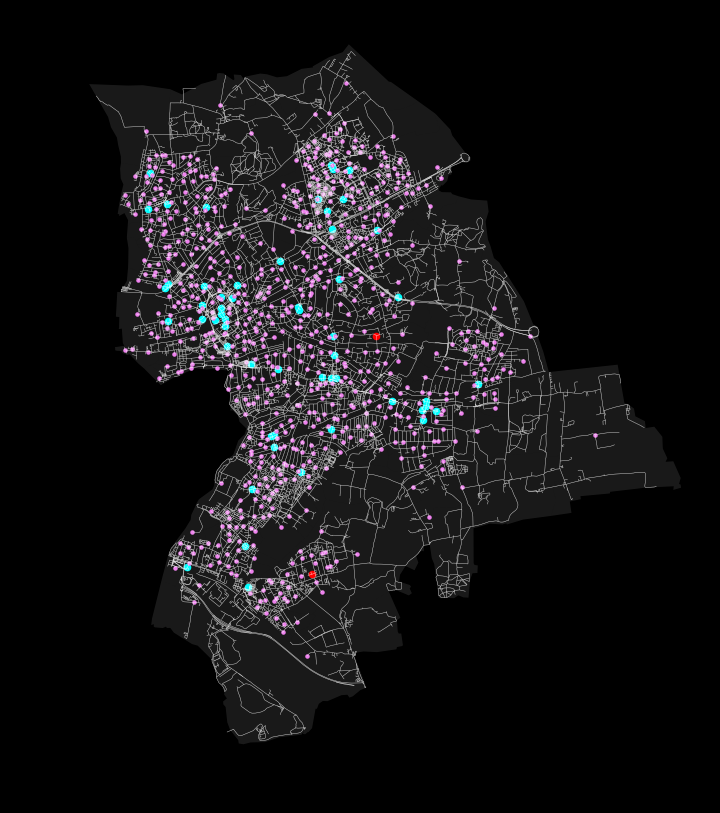

In [31]:
# let us plot the centroids in the map
oa_centroids = nodes.loc[oa['nodes'].unique()]
selected_nodes= nodes.loc[selected_nodes_ids]
fig, ax = plt.subplots(figsize=(10, 10), facecolor='k')
oa.plot(ax=ax, facecolor='w', alpha=0.1)
edges.plot(color='w', ax=ax, linewidth=0.3, alpha=0.5)
retail.plot(color='cyan', ax=ax, markersize=20)
oa_centroids.plot(ax=ax, color='violet', markersize=5)
selected_nodes.plot(ax=ax, color='red', markersize=20)
ax.set_facecolor('k')
plt.show()

In [32]:
# Get origin and destination node lists

# Origin nodes from all OA centroids
origin_nodes = oa['nodes'].values


In [39]:
# Combine all destination nodes: retail + the 2 selected OAs
destination_nodes = list(retail['nodes'].values) + list(selected_nodes_ids)

In [40]:
# let us compute the distance matrix

# Create an empty distance matrix
distance_matrix = pd.DataFrame(index=origin_nodes, columns=destination_nodes)

# Compute shortest path lengths
for origin in origin_nodes:
    lengths = nx.single_source_dijkstra_path_length(G, origin, weight='length')
    for dest in destination_nodes:
        distance_matrix.loc[origin, dest] = lengths.get(dest, float('inf'))  # 'inf' if no path


In [42]:
distance_matrix

,3126695258,33472352,2905549031,4525271306,1723271155,7097574945,31073549,11227619384,245794863,11909545221,...,245037871,1612627338,2962708960,2733299480,11599007720,3787358413,6970755181,7265453259,31499457,255145090
691436925,11961.496696,3275.920817,2632.983056,3064.793628,6811.884116,4950.937909,2914.283756,2547.495609,5006.431217,3575.925235,...,2696.907899,2666.322691,7638.959722,7278.364217,7694.50773,7035.370623,8244.437735,4997.127201,6190.720499,11356.220701
177734560,10245.14298,2008.770715,1365.832954,1356.197792,5532.309332,3242.342074,1647.133654,1267.920825,4135.589861,2308.775133,...,1639.446306,1386.747908,5930.363886,5569.768381,6415.847282,6014.433858,7233.77789,3280.773485,4911.145716,9647.624865
5219365188,11566.421195,2880.845316,2237.907556,2669.718128,6416.808615,4555.862409,2519.208256,2152.420108,4611.355716,3180.849734,...,2301.832398,2271.247191,7243.884222,6883.288716,7299.432229,6640.295122,7849.362235,4602.0517,5795.644999,10961.145201
1429395187,9931.798972,1928.798235,1285.860475,1035.095905,5452.336853,2921.240186,1567.161175,1187.948346,4055.617381,2228.802653,...,1559.473827,1306.775428,5609.261998,5248.666493,6335.874802,5934.461379,7153.805411,2967.429477,4716.897218,9326.522978
31386337,9400.936952,1897.918481,1461.026492,511.991764,5141.244452,2398.136045,1545.88618,1154.037815,4230.783398,2220.768677,...,1734.639844,1259.295373,5086.157858,4725.562353,6120.090344,5718.67692,6938.020953,2436.567457,4221.631041,8803.418837
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10282603620,10284.432104,1155.560338,512.622578,1366.801182,4981.806576,3252.945463,793.923278,697.044129,3282.379484,1455.564756,...,786.23593,604.662201,5940.967276,5580.371771,5640.866914,5239.45349,6458.797523,3320.062609,4373.688617,9658.228255
5151949179,10447.965343,1348.42577,705.48801,1530.334421,5163.691928,3416.478702,986.78871,889.909561,3475.244916,1648.430188,...,979.101362,797.527633,6104.500515,5743.90501,5833.732346,5432.318922,6651.662955,3483.595847,4542.528311,9821.761494
12003524846,4569.049517,7594.215477,7261.320659,5874.700414,9430.732382,5695.465208,7242.183176,6850.334811,9984.26088,7917.065673,...,7534.934011,6955.592369,7753.53071,7392.935204,10610.022767,10319.912052,11427.953375,4005.128084,7560.797303,6273.456068
4692424674,11612.923255,4775.415072,4820.309339,5276.531215,647.762068,3801.644813,4632.518073,4525.156804,4164.814238,4109.853842,...,5154.547538,4492.461898,6075.314991,5714.719485,1677.270736,1983.736911,2327.32595,5980.780219,3632.27824,10096.656738


In [51]:
# Add OA21CD as index labels
distance_matrix.index = oa['OA21CD'].values

# Label destination columns: retail + selected OAs
retail_labels = retail['id'].astype(str).values  # ensures strings
selected_labels = oa_ids
distance_matrix.columns = list(retail_labels) + selected_labels

In [52]:
distance_matrix

,1010006288,1010000785,1010003189,1010006287,1010006290,1010003188,1010001545,1010007336,1010014462,1010006056,...,1010005548,1010021837,1010006762,1010000405,1010022862,1010020576,1010015073,1010005537,E00011326,E00011710
E00011202,11961.496696,3275.920817,2632.983056,3064.793628,6811.884116,4950.937909,2914.283756,2547.495609,5006.431217,3575.925235,...,2696.907899,2666.322691,7638.959722,7278.364217,7694.50773,7035.370623,8244.437735,4997.127201,6190.720499,11356.220701
E00011203,10245.14298,2008.770715,1365.832954,1356.197792,5532.309332,3242.342074,1647.133654,1267.920825,4135.589861,2308.775133,...,1639.446306,1386.747908,5930.363886,5569.768381,6415.847282,6014.433858,7233.77789,3280.773485,4911.145716,9647.624865
E00011204,11566.421195,2880.845316,2237.907556,2669.718128,6416.808615,4555.862409,2519.208256,2152.420108,4611.355716,3180.849734,...,2301.832398,2271.247191,7243.884222,6883.288716,7299.432229,6640.295122,7849.362235,4602.0517,5795.644999,10961.145201
E00011205,9931.798972,1928.798235,1285.860475,1035.095905,5452.336853,2921.240186,1567.161175,1187.948346,4055.617381,2228.802653,...,1559.473827,1306.775428,5609.261998,5248.666493,6335.874802,5934.461379,7153.805411,2967.429477,4716.897218,9326.522978
E00011206,9400.936952,1897.918481,1461.026492,511.991764,5141.244452,2398.136045,1545.88618,1154.037815,4230.783398,2220.768677,...,1734.639844,1259.295373,5086.157858,4725.562353,6120.090344,5718.67692,6938.020953,2436.567457,4221.631041,8803.418837
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
E00176973,10284.432104,1155.560338,512.622578,1366.801182,4981.806576,3252.945463,793.923278,697.044129,3282.379484,1455.564756,...,786.23593,604.662201,5940.967276,5580.371771,5640.866914,5239.45349,6458.797523,3320.062609,4373.688617,9658.228255
E00176974,10447.965343,1348.42577,705.48801,1530.334421,5163.691928,3416.478702,986.78871,889.909561,3475.244916,1648.430188,...,979.101362,797.527633,6104.500515,5743.90501,5833.732346,5432.318922,6651.662955,3483.595847,4542.528311,9821.761494
E00176975,4569.049517,7594.215477,7261.320659,5874.700414,9430.732382,5695.465208,7242.183176,6850.334811,9984.26088,7917.065673,...,7534.934011,6955.592369,7753.53071,7392.935204,10610.022767,10319.912052,11427.953375,4005.128084,7560.797303,6273.456068
E00176979,11612.923255,4775.415072,4820.309339,5276.531215,647.762068,3801.644813,4632.518073,4525.156804,4164.814238,4109.853842,...,5154.547538,4492.461898,6075.314991,5714.719485,1677.270736,1983.736911,2327.32595,5980.780219,3632.27824,10096.656738


In [53]:
distance_matrix.to_csv("oa_to_retail_and_selected_nodes_distance_matrix.csv")